# Capstone Project - The Battle of the Neighborhoods #
## Applied Data Science Capstone by IBM/Coursera ##
### Fernando Tauscheck ###

## Table of contents:
1. [Introduction: Business Problem](#introduction)
    1.1 Curitiba:
2. [Data](#data)
    2.1 Start the code:
    2.2 Foursquare:
        2.2.1 Retrieve Curitiba Coordinates - Google Geocode:
        2.2.2 Calculating reference points to request Venues from FourSquare API:
        2.2.3 Request Venues (and details) to FourSquare API:
            2.2.3.2 Dataframe of Venues:
    2.3 Geographic Data:
        2.3.1 Loading Neighborhoods GeoJSON to Database:
            2.3.1.1 Plotting Neighborhoods:
        2.3.2 Loading Master Plan GeoJSON to Database:
            2.3.2.1 Plotting Master Plan:
        2.3.3 Loading Main Streets GeoJSON to Database:
        2.3.4 Loading Main Streets GeoJSON to Database:
        2.3.5 Socioeconomic data of the neighborhoods:
3. [Methodology:](#methodology)
4. [Analysis:](#analysis)
    4.1 Creating hexagon to study:
    4.2 Hexagons vs Geographic Data:
        4.2.1 Socioeconomic data of each Hexagons:
        4.2.2 Master Plan of each Hexagons:
        4.2.3 Main Streets of each Hexagons:
        4.2.4 Extras of each Hexagons:
    4.3 Processing data:
        4.3.1 Normalizing:
        4.3.2 Clustering:
    4.4 Bringing Foursquere data into analysis:
        4.4.1 Venues per Hexagon:
        4.4.2 Venues distance to Hexagon:
    4.4 Defining the relevant clusters:
    4.5 Defining the relevant clusters:
    4.6 A peek in the data:
        4.6.1 Hexagon per Population and per Income:
    4.7 Ranking:
5. [Results and Discussion:](#Results)
6. [Conclusion:](#Conclusion)

## 1. Introduction: Business Problem

What defines the success of a commercial business? Can we predict if a point is good enough to open a profitable bakery?

Although the analysis can, in theory, be replicated for any type of business, this report will be targeted to stakeholders interested in opening a bakery in Curitiba, Brazil. We will use geographic and socioeconomic data from existing bakeries to define a short ranked list of possibles location.

### 1.1 Curitiba:

Curitiba is the capital and largest city in the Brazilian state of Paraná. The city's population was 1,948,626 as of 2020, making it the eighth-most populous city in Brazil and the largest in Brazil's South Region. According to Foursquare, Curitiba has 608 bakeries, of which: 
* 17 (1.4%) have ratings greater than 9; 
* 21 (3.4%) were classified as high cost;

In [13]:
%%html
<style>
img[src$="centerme"] {display:block;margin: 0 auto;}
</style>

time: 47 ms (started: 2021-08-18 21:51:06 -03:00)


![Curitiba](https://github.com/ftauscheck/The-Battle-of-the-Neighborhoods/blob/main/img/01.Curitiba.png?raw=true?style=centerme)

## 2. Data:

Some factors will influence our analysis:
* Number of existing bakeries in the neighborhood;
* Socioeconomic data of the neighborhoods (Per capita income, population density, ...);
* Zones from City Master Plan;
* Proximity to parks, public square, boardwalk, main streets, and avenues of great circulation;

As a data aggregation tool, RDMBS PostgreSQL will be used with PostGIS.

### 2.1: Start the code:

In [30]:
# Load necessary libraries
import configparser
import psycopg2
from psycopg2.extras import RealDictCursor
import numpy as np
import pandas as pd
import plotly.express as px
import json
import requests
import unidecode
from bs4 import BeautifulSoup
import math # for radians()
from geopy import distance
from functools import reduce
import folium
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans 
%load_ext autotime

# Retrieve configuration (using ConfigParser library)
config = configparser.ConfigParser()
config.read('config.ini')

database = config['postgis']
foursquare = config['foursquare_api']
gmaps_token = config['google_api']['key']
mapbox_token = config['mapbox_api']['key']

# Connect to PostgreSQL database
conn_string = "host='"+ database['host'] +"' user='" + database['user'] + "' password='"+ database['passwd']+"'"
psql = psycopg2.connect(conn_string)
cur = psql.cursor(cursor_factory=RealDictCursor)

# Function to plot maps:
def draw_plotly_map(plot_type, dataframe, lat_center, long_center, hover_data, color_column, color, zoom, title, geojson=None, height=500, showlegend=False, lat_column=None, long_column=None, locations=None, featureidkey=None):
    if plot_type == "scatter" :
        fig = px.scatter_mapbox(dataframe, 
            lat=lat_column, 
            lon=long_column, 
            hover_data=hover_data,
            color=color_column,
            zoom=zoom, 
            center = {"lat": lat_center, "lon": long_center},
            color_continuous_scale=color,
            height=height,
            title=title)
        fig.update_layout(mapbox_style="outdoors", mapbox_accesstoken=mapbox_token)
        fig.update_layout(title_y=1,margin={"r":0,"t":30,"l":0,"b":0},title_pad={"t":10})
        fig.update_layout(showlegend=showlegend)
        fig.show()
    elif plot_type == "choropleth" :
        fig = px.choropleth_mapbox(dataframe, 
            geojson=geojson, 
            color=color_column,
            locations=locations,
            featureidkey=featureidkey,
            hover_data=hover_data,
            zoom=zoom, 
            center = {"lat": lat_center, "lon": long_center},
            opacity=0.3,
            color_discrete_sequence=color,
            height=height,
            title=title)
        fig.update_layout(mapbox_style="outdoors", mapbox_accesstoken=mapbox_token)
        fig.update_layout(title_y=1,margin={"r":0,"t":30,"l":0,"b":0},title_pad={"t":10})
        fig.update_layout(showlegend=showlegend)
        fig.show()
    else:
        print("Missing arguments...")

The autotime extension is already loaded. To reload it, use:
  %reload_ext autotime
time: 125 ms (started: 2021-08-18 22:02:53 -03:00)


### 2.2 Foursquare: <a name="foursquare"></a> ###

This project uses the Foursquare API as its main data gathering source as it has a database of millions of venues. To restrict the number of venues to request to Foursquare API, only places classified as bakery were filtered. 
To mitigate the problem with neighborhoods with more than 100 bakeries (an API limitation), we will query the API in clusters of hexagons with 600m of radius. The coordinates of these hexagons were generated through code, starting from a central point in Curitiba. All points were validated if they were 'within' the Curitiba area through a SQL query. The coordinate of the central point was defined with a request to ‘Google Geocode API’ using the neighborhood ‘Fany’ as the parameter. 
With the venues list, an additional request was made to retrieve details of each venue:
* Rating;
* Likes;
* Tier;
* Multi-classification: For example, a Bakery with a grocery store;

#### 2.2.1 Retrieve Curitiba Coordinates - Google Geocode: <a name="geocode"></a> ####

Starting from a geographically central point in Curitiba (not necessarily in the downtown area), we use the Google Geocode API to obtain the coordinates of this point. 
These coordinates will be used as the starting point for defining the collection and analysis points, and as the center point of the maps used in this report.

The *"Fanny"* neighborhood will be the starting point.

In [15]:
def get_coordinates(api_key, address, verbose=False):
    try:
        url = 'https://maps.googleapis.com/maps/api/geocode/json?key={}&address={}'.format(api_key, address)
        response = requests.get(url).json()
        if verbose:
            print('Google Maps API JSON result =>', response)
        results = response['results']
        geographical_data = results[0]['geometry']['location'] # get geographical coordinates
        lat = geographical_data['lat']
        lon = geographical_data['lng']
        return [lat, lon]
    except:
        return [None, None]

verbose = True
address = 'Fanny, Curitiba - PR, Brasil'
curitiba_center = get_coordinates(gmaps_token, address)
curitiba_lat = round(curitiba_center[0], 6)
curitiba_long = round(curitiba_center[1], 6)
print('Coordinate of {}: {}'.format(address, curitiba_center))

Coordinate of Fanny, Curitiba - PR, Brasil: [-25.4833853, -49.27074409999999]
time: 859 ms (started: 2021-08-18 21:51:21 -03:00)


#### 2.2.2 Calculating reference points to request Venues from FourSquare API: ####

With the definition, in the previous function, of the central coordinates, equidistant points (vertices of hexagons) will be defined covering the entire area of the municipality. Starting from these points, the Foursquare API will be questioned (providing a calculated radius).

In [3]:
def calc_points(azimuth_start, azimuth_step, radius, lat, long):
    lat = math.radians(lat)
    long = math.radians(long)
    temp_content=[]
    azimuth = azimuth_start
    while azimuth < (360 + azimuth_start):
        point = {}
        tc = math.radians(azimuth)
        temp_lat = math.degrees(math.asin(math.sin(lat)*math.cos(radius) + math.cos(lat)*math.sin(radius)*math.cos(tc)))
        if math.cos(long) == 0 :
            temp_lon = math.degrees(long)
        else:
            temp_lon = math.degrees(((long + math.asin(math.sin(tc)*math.sin(radius) / math.cos(lat)) + math.pi) % (2*math.pi)) - math.pi)
        point['lat'] = round(temp_lat, 6)
        point['long'] = round(temp_lon, 6)
        point['distance'] = None
        point['valid'] = None
        point['checked'] = False
        temp_content.append(point)
        azimuth += azimuth_step
    return temp_content

def point_is_in_curitiba(lat, long):
    # Check it point is inside any Curitiba neighbourhood (ST_CONTAIS):
    query = "SELECT count(a.id) as num FROM project.geo_neighbourhood a \
            WHERE ST_CONTAINS(a.geometry, ST_PointFromText('POINT(%s %s)', 4326));"
    cur.execute(query, (round(long, 6), round(lat, 6)))
    result = cur.fetchone()
    return result['num']

def return_df_points(azimuth_start, lat_center, long_center, hexagon_apothem, max_radius):
    azimuth_step = 60 
    radius = 2*hexagon_apothem/distance.EARTH_RADIUS
    final_list=[]

    # Add start point to list
    point = {}
    point['lat'] = lat_center
    point['long'] = long_center
    point['distance'] = 0
    point['valid'] = True
    point['checked'] = True
    final_list.append(point)

    main_point = (lat_center, long_center)
    temp_list = calc_points(azimuth_start, azimuth_step, radius, lat_center, long_center)
    final_list.extend(temp_list)
    new_item = True
    while new_item == True:
        new_item = False
        temp_list = []
        for line in final_list:
            if line['checked'] != True:
                point = (line['lat'], line['long'])
                dist = distance.great_circle(main_point, point).km
                if dist > max_radius:
                    line['checked'] = True
                    line['distance'] = dist
                    line['valid'] = False
                else:
                    line['valid'] = True
                    line['reason'] = point_is_in_curitiba(line['lat'], line['long'])
                    # check if point is also on list
                    for linecheck in final_list:
                        #print('{} and {} and {}'.format(abs(linecheck['lat'] - line['lat']), abs(linecheck['long'] - line['long']), linecheck['checked']))
                        if abs(linecheck['lat'] - line['lat']) < 0.0001 and abs(linecheck['long'] - line['long']) < 0.0001 and linecheck['checked'] == True:
                            line['valid'] = False
                            break
                    
                    # Check if point is in Curitiba (using MySQL)
                    if line['valid'] == True and point_is_in_curitiba(line['lat'], line['long']) == 0:
                        line['valid'] = False
                    line['checked'] = True
                    line['distance'] = dist
                    if line['valid'] == True:
                        new_item = True
                        temp_list.extend(calc_points(azimuth_start, azimuth_step, radius, line['lat'], line['long']))
        if new_item == True:
            final_list.extend(temp_list)
    final_list[:] = [x for x in final_list if x['valid'] == True]
    return pd.DataFrame(final_list)

df_search_points = ""
# First try to read parquet file
try:
    df_search_points = pd.read_parquet('./parquet/points.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    # Create a list of points:
    azimuth_start = 30
    df_search_points = return_df_points(azimuth_start, curitiba_lat, curitiba_long, 1, 20)
    df_search_points.to_parquet('./parquet/points.parquet')
    print("Parquet file saved.")

print('Dataframe have {} reference points.'.format(df_search_points.shape[0]))

Parquet file readed.
Dataframe have 127 reference points.
time: 828 ms (started: 2021-08-17 09:56:46 -03:00)


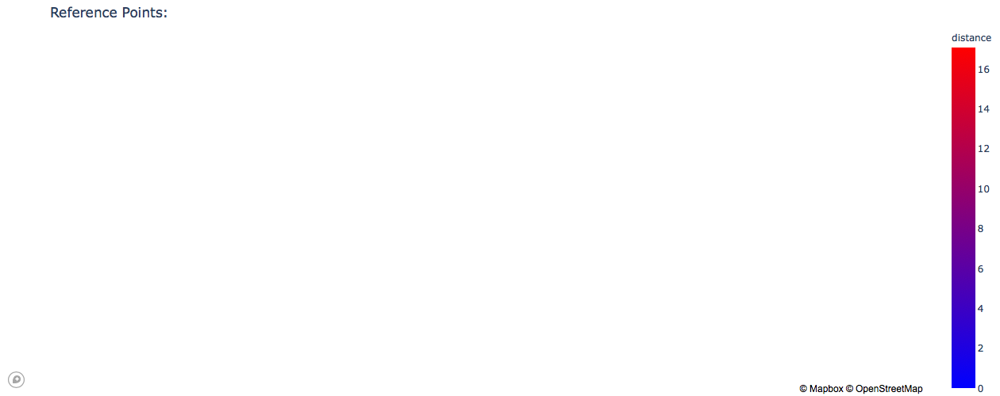

time: 203 ms (started: 2021-08-18 22:03:01 -03:00)


In [31]:
draw_plotly_map("scatter", df_search_points, curitiba_lat, curitiba_long, ["distance", "reason"], "distance", px.colors.sequential.Bluered, 9.8, "Reference Points:", lat_column="lat", long_column="long")  

#### 2.2.3 Request Venues (and details) to FourSquare API: ####

With the points calculated in the previous function, the Foursquare API is called. As query radius for the API, we used the vertex of the hexagon plus a 1% margin of error. 

The output of this code is directly stored in a table on PostgreSQL.

In [ ]:
def get_venues_near(index, lat, lon, category, interest_category, client_id, client_secret, version, radius=1000, limit=100):
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}&locale=en'.format(client_id, client_secret, version, lat, lon, category, radius, limit)
    all_json = requests.get(url).json()
    totalResults = all_json['response']['totalResults']
    if totalResults > 100:
        print('Point with more than 100 venues ({} venues).'.format(all_json['response']['totalResults']), end='')
    elif totalResults == 0:
        print('.', end='')
    else:
        results = all_json['response']['groups'][0]['items']
        for item in results:
            id_venue = item['venue']['id']
            check_nenue = venue_in_database(id_venue)
            name = item['venue']['name']
            lat = item['venue']['location']['lat']
            long = item['venue']['location']['lng']
            address = "" if dot_get(item['venue'], 'location.address') == None else dot_get(item['venue'], 'location.address')
            categories = get_categories(item['venue']['categories'])
            if check_nenue == False:
                print('N', end='')
                categories, tipCount, likes, tier, rating, verified = venue_detail(id_venue, categories, client_id, client_secret, version)
                sql_insert = 'INSERT INTO project.foursquare_venues (id, name, lat, long, geo_point, address, categories, tipCount, tier, rating, index_df, totalResults, likes, verified) \
                    SELECT * FROM (SELECT %s as id, %s as name, %s as lat, %s as long, ST_PointFromText(\'POINT(%s %s)\', 4326) as geo_point, \
                    %s as address, %s as categories, %s as tipCount, %s as tier, %s as rating, %s as index_df, %s, %s as likes, %s as verified) as tmp \
                    WHERE NOT EXISTS (SELECT id FROM project.foursquare_venues WHERE id = %s) LIMIT 1;'
                cur.execute(sql_insert, (id_venue, name, lat, long, long, lat, address, categories, tipCount, tier, rating, index, totalResults, likes, verified, id_venue))
            elif check_nenue == 'detail':
                print('D', end='')
                categories, tipCount, likes, tier, rating, verified = venue_detail(id_venue, categories, client_id, client_secret, version)
                sql_update = "UPDATE project.foursquare_venues set (categories = {}, tipCount = {}, likes = {}, tier = {}, rating = {}, verified = {}) WHERE id = {};"
                cur.execute(sql_insert, (categories, tipCount, likes, tier, rating, verified, id_venue))
            
        print('.', end='')
        psql.commit()

def get_categories(categories):
    return json.dumps([(cat['name'], cat['id']) for cat in categories])

def dot_get(dictionary, dot_path, default=None):
    path = dot_path.split('.')
    try:
        return reduce(dict.__getitem__, path, dictionary)
    except KeyError:
        return default
    except TypeError:
        return default

def venue_detail(id_venue, categories, client_id, client_secret, version):
    url_venue = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}&locale=en'.format(id_venue,client_id, client_secret, version)
    venue_detail = requests.get(url_venue).json()
    venue = dot_get(venue_detail, 'response.venue')
    if venue == None:
        categories = categories
        tipCount = None
        likes = None
        tier = None
        rating = None
        verified = None
    else:
        categories = get_categories(venue['categories'])
        tipCount = 0 if dot_get(venue, 'stats.tipCount') == None else dot_get(venue, 'stats.tipCount')
        likes =  0 if dot_get(venue, 'likes.count') == None else dot_get(venue, 'likes.count')
        tier = 0 if dot_get(venue, 'price.tier') == None else dot_get(venue, 'price.tier')
        rating = 0 if dot_get(venue, 'rating') == None else dot_get(venue, 'rating')
        verified = 1 if venue['verified'] == True else 0
    return categories, tipCount, likes, tier, rating, verified

def venue_in_database(id_venue):
    query = "SELECT count(id) as id, MAX(tipCount) \"tipCount\" FROM project.foursquare_venues a WHERE id = '" + id_venue + "';"
    cur.execute(query)
    result = cur.fetchone()
    if result['id'] == 0:
        return False
    elif result['tipCount'] == None:
        return 'detail'
    else:
        return 'Ok'
    
# Given the hexagon apothem, calc his radius.
hexagon_apothem = 1
hexagon_radius = math.sqrt(4*hexagon_apothem**2/3)*1010 # in meters plus 1%

base_category = '4bf58dd8d48988d16a941735' # Food category 
interest_category = set(['4bf58dd8d48988d16a941735', '4bf58dd8d48988d179941735', '4bf58dd8d48988d1d0941735','4bf58dd8d48988d1f5941735', '4bf58dd8d48988d16d941735', '4bf58dd8d48988d128941735'])
x = 1
for index, row in df_search_points.iterrows():
    get_venues_near(index, row['lat'], row['long'], base_category, interest_category, foursquare['user_key'], foursquare['user_secret'], foursquare['version'], hexagon_radius, 100)
    if x > 140:
        # To prevent an infinite loop using out quota at FourSquare API
        break
    x += 1

Parquet file readed.


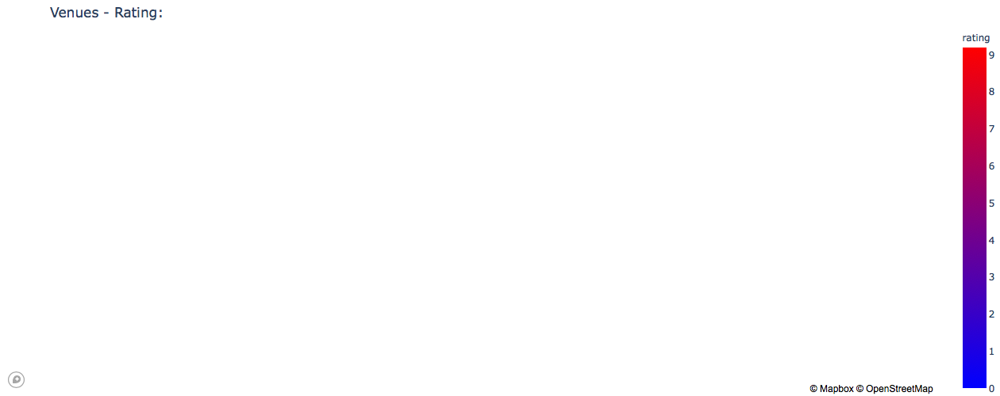

time: 953 ms (started: 2021-08-18 21:59:00 -03:00)


In [26]:
try:
    df_venues = pd.read_parquet('./parquet/venues.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_venues = pd.read_sql('SELECT id, name, lat, long, address, categories, tipCount, tier, likes, rating, verified, ST_AsGeoJSON(geo_point) as geo_point, ST_AsGeoJSON(area) as area, index_df, totalResults FROM project.foursquare_venues', con=psql)
    df_venues.to_parquet('./parquet/venues.parquet')

draw_plotly_map("scatter", df_venues, curitiba_lat, curitiba_long, ["name", "rating"], "rating", px.colors.sequential.Bluered, 9.8, "Venues - Rating:", lat_column="lat", long_column="long")  

##### 2.2.3.2 Dataframe of Venues: #####

In [9]:
df_venues[['id', 'name', 'lat', 'long', 'address', 'categories', 'tipcount', 'tier', 'likes', 'rating']].head()

,id,name,lat,long,address,categories,tipcount,tier,likes,rating
0,4b69efebf964a5201bbd2be3,Confeitaria das Famílias,-25.430643,-49.270212,"R. Quinze de Novembro, 374","[[""Dessert Shop"", ""4bf58dd8d48988d1d0941735""],...",114,1,235,6.7
1,4b75d4fcf964a520ee272ee3,Panetteria Maiochi,-25.472368,-49.288013,"R. Maranhão, 1730","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Con...",22,1,34,6.3
2,4b7c57d1f964a5209f8d2fe3,La Patisserie,-25.442422,-49.279188,"Av. Sete de Setembro, 4194","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Cof...",71,2,111,6.3
3,4b8abddbf964a520c07d32e3,Saint Germain,-25.432826,-49.290227,"Al. Prca. Izabel, 1347","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Del...",57,3,221,6.9
4,4ba29a89f964a520680838e3,Saint Germain,-25.444152,-49.287664,"Av. Visc. de Guarapuava, 4882","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Bre...",180,3,617,7.8


time: 78 ms (started: 2021-08-09 01:30:22 -03:00)


### 2.3 Geographic Data: <a name="data_geolocated"></a> ###

We will get geographic information from Curitiba at the website of the *"Instituto de Pesquisa e Planejamento Urbano de Curitiba"* (Institute of Urban Planning and Research of Curitiba also know as IPPUC)[^1]. The Institute provides all sorts of maps of Curitiba. We will use:

* Zones of City Master Plan;
* Neighborhoods;
* Mains streets;
* Boardwalks, public squares, and parks 

These maps are provided in SHP format (ESRI). Posteriorly they were converted to GeoJSON in a proper representation (WGS84). The GeoJSON files was inserted in an RDMBS (PostgreSQL), where will be used the Post GIS extension to analyze. At the GitHub of this project[^2], you can find the structure of the tables (SQL File).

[^1]: https://ippuc.org.br/geodownloads/geo.htm
[^2]: https://github.com/ftauscheck/The-Battle-of-the-Neighborhoods/tree/main/support

#### 2.3.1 Loading Neighborhoods GeoJSON to Database: <a name="load_neighborhoods"></a> ####
Load file support/GeoJSON/Curitiba_neighbourhood.geojson into a PostgreSQL table.

In [11]:
cur.execute("TRUNCATE project.geo_neighbourhood;")
x = 0
with open('support/GeoJSON/Curitiba_neighbourhood.geojson', encoding='utf-8') as json_file:
    insert = 'INSERT INTO project.geo_neighbourhood (id, type, neighbourhood, norm_neighbourhood, area, sectional_id, sectional_name, geometry) VALUES ('
    data = json.load(json_file)
    for f in data['features']:
        id = f['properties']['CODIGO']
        type =  f['properties']['TIPO']
        neighbourhood=  f['properties']['NOME']
        norm_neighbourhood=  unidecode.unidecode(neighbourhood).upper()
        area = f['properties']['SHAPE_AREA']
        sectional_id = f['properties']['CD_REGIONA']
        sectional_name = f['properties']['NM_REGIONA']
        geometry = json.dumps(f['geometry'])
        sql_insert = insert + str(id) + ', \''+ type + '\', \'' + neighbourhood + '\', \'' + norm_neighbourhood + '\', ' + str(area) + ', ' + str(sectional_id)+ ', \'' + sectional_name + '\', ST_GeomFromGeoJSON(\'' + geometry + '\'));'
        cur.execute(sql_insert)
        x = x + 1
psql.commit()
print('Neighbourhood: INSERT {}'.format(x))

# The '_simples' file is used only to speed up the mapping plot in this notebook.
x = 0
with open('support/GeoJSON/Curitiba_neighbourhood_simple.geojson', encoding='utf-8') as json_file:
    data = json.load(json_file)
    for f in data['features']:
        id = f['properties']['CODIGO']
        geometry = json.dumps(f['geometry'])
        sql_update = 'UPDATE project.geo_neighbourhood SET geometry_simple = ST_GeomFromGeoJSON(\'' + geometry + '\') WHERE id = ' + str(id) + ';'
        cur.execute(sql_update)
        x = x + 1
psql.commit()
print('Neighbourhood: UPDATE {}'.format(x))
psql.close()

Neighbourhood: INSERT 75
Neighbourhood: UPDATE 75
time: 1.62 s (started: 2021-08-09 01:37:08 -03:00)


##### 2.3.1.1 Plotting Neighborhoods: <a name="plotting_neighborhoods"></a> #####

In [32]:
# Prepare data to display Neighborhoods:
#  Using PostGIS geometry_simple collumn to reduce time to draw maps. 
#  To make the analisys will be used column geometry.

geo_neigh = {"type": "FeatureCollection", "name": "ZONEAMENTO", "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" }}, 'features' : []}

sql_neigh = "SELECT a.id, a.neighbourhood AS \"Neighbourhood\", a.sectional_name as \"Sector\", ST_AsGeoJSON(a.geometry_simple) AS geo \
            FROM project.geo_neighbourhood a \
            ORDER BY a.neighbourhood, a.sectional_name;"

cur.execute(sql_neigh)
temp_content = []
for record in cur:
    cell = {'properties':{}}
    properties = {}
    cell_df = {}
    cell['type'] = "Feature"
    cell['id'] = record['id']
    properties['id'] = record['id']
    properties['Neighbourhood'] = record['Neighbourhood']
    properties['Borough'] = record['Sector']
    
    cell_df['id'] = record['id']
    cell_df['Neighbourhood'] = record['Neighbourhood']
    cell_df['Sector'] = record['Sector']

    cell['geometry'] = json.loads(record['geo'])
    cell['properties'].update(properties)
    geo_neigh['features'].append(cell)
    temp_content.append(cell_df)

df_neigh=pd.DataFrame(temp_content)
psql.commit()

draw_plotly_map("choropleth", df_neigh, curitiba_lat, curitiba_long, ['Sector'], "Neighbourhood", px.colors.qualitative.Dark24, 9.8, "Curitiba Neighbourhoods", geojson=geo_neigh, locations="id", featureidkey="properties.id", showlegend=True)

time: 21.8 s (started: 2021-08-18 22:03:23 -03:00)


#### 2.3.2 Loading Master Plan GeoJSON to Database: <a name="load_masterplan"></a> ####
Load file support/GeoJSON/Curitiba_master_plan.geojson into a PostgreSQL table.

In [8]:
# Prepare data to display Master Plan:
#  Using MySQL geometry_simple collumn to reduce time to draw maps. To make the analisys will be used column geometry.

cur.execute("TRUNCATE project.geo_master_plan;")
x = 0
y = 0
with open('support/GeoJSON/Curitiba_master_plan.geojson', encoding='utf-8') as json_file:
    insert = 'INSERT INTO project.geo_master_plan (nm_groups, cd_zone, nm_zone, sg_zone, area, lenght, geometry) VALUES ('
    data = json.load(json_file)
    for f in data['features']:
        if f['geometry']['type'] == 'Polygon' or f['geometry']['type'] == 'MultiPolygon' :
            nm_groups = f['properties']['NM_GRUPO']
            cd_zone =  "" if f['properties']['CD_ZONA'] == None else f['properties']['CD_ZONA']
            nm_zone =  f['properties']['NM_ZONA']
            sg_zone = f['properties']['SG_ZONA']
            area =  f['properties']['AREA']
            lenght = f['properties']['LEN']
            geometry = json.dumps(f['geometry'])
            sql_insert = insert + ' \''+ nm_groups + '\', \'' + cd_zone + '\', \'' + nm_zone + '\', \'' + sg_zone + '\', ' + str(round(area,6)) + ',  ' + str(round(lenght,6)) + ', ST_GeomFromGeoJSON(\'' + geometry + '\'));'
            cur.execute(sql_insert)
            y = y + 1
        x = x + 1
psql.commit()
print('Master Plan: INSERT {} of {}'.format(y, x))

# Update DB with simplified version of GeoJSON (to speedup visualization)
x = 0
y = 0
with open('support/GeoJSON/Curitiba_master_plan_simple.geojson', encoding='utf-8') as json_file:
    data = json.load(json_file)
    for f in data['features']:
        if f['geometry']['type'] == 'Polygon' or f['geometry']['type'] == 'MultiPolygon' :
            cd_zone =  "" if f['properties']['CD_ZONA'] == None else f['properties']['CD_ZONA']
            area =  f['properties']['AREA']
            lenght = f['properties']['LEN']
            geometry = json.dumps(f['geometry'])
            sql_update = 'UPDATE project.geo_master_plan SET geometry_simple = ST_GeomFromGeoJSON(\'' + geometry + '\') WHERE cd_zone = \'' + cd_zone + '\' AND area = ' + str(round(area,6)) + ' AND lenght = ' + str(round(lenght,6)) + ';'
            cur.execute(sql_update)
            y = y + 1
        x = x + 1
psql.commit()
print('Master Plan: UPDATE {} of {}'.format(y, x))

Master Plan: INSERT 241 of 241
Master Plan: UPDATE 241 of 241
time: 1.88 s (started: 2021-08-11 00:33:07 -03:00)


##### 2.3.2.1 Plotting Master Plan: <a name="plotting_masterplan"></a> #####

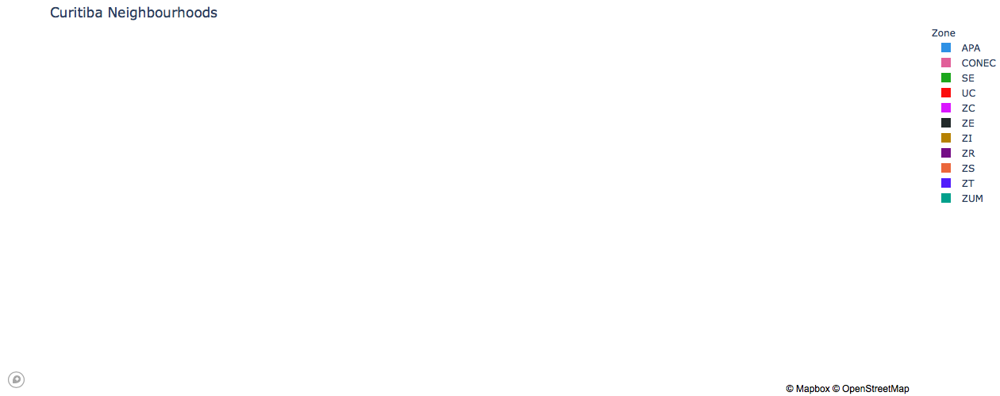

time: 30.9 s (started: 2021-08-18 22:06:00 -03:00)


In [33]:
# Prepare data to display Master Plan:
#  Using PostGIS geometry_simple collumn to reduce time to draw maps. 
#  To make the analisys will be used column geometry.

geo_mp = {"type": "FeatureCollection", "name": "ZONEAMENTO", "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" }}, 'features' : []}
sql_mp = "SELECT b.sg_short AS alias, a.sg_zone AS sigla, \
    a.nm_zone AS name, a.id AS id_zone, ST_AsGeoJSON(a.geometry_simple) AS geo \
    FROM project.geo_master_plan a LEFT JOIN \
    project.zones_adjust2 b ON a.sg_zone = b.sg_zone \
    ORDER BY b.sg_short, a.sg_zone;"

cur.execute(sql_mp)
temp_content = []
for record in cur:
    cell = {'properties':{}}
    properties = {}
    cell_df = {}
    cell['type'] = "Feature"
    cell['id'] = record['id_zone']
    properties['id'] = record['id_zone']
    properties['name'] = record['name']
    
    cell_df['id'] = record['id_zone']
    cell_df['Zone'] = record['alias']
    cell_df['Acronym'] = record['sigla']
    cell_df['Name'] = record['name']

    cell['geometry'] = json.loads(record['geo'])
    cell['properties'].update(properties)
    geo_mp['features'].append(cell)
    temp_content.append(cell_df)

df_mp=pd.DataFrame(temp_content)
psql.commit()

draw_plotly_map("choropleth", df_mp, curitiba_lat, curitiba_long, ['Acronym', 'Name'], "Zone", px.colors.qualitative.Dark24, 9.8, "Curitiba Neighbourhoods", geojson=geo_mp, locations="id", featureidkey="properties.id", showlegend=True)

#### 2.3.3 Loading Main Streets GeoJSON to Database: <a name="load_mainstreets"></a> ####
Load file support/GeoJSON/Curitiba_main_streets.geojson into a PostgreSQL table.

In [15]:
x = 1
with open('support/GeoJSON/Curitiba_main_streets.geojson', encoding='utf-8') as json_file:
    insert = 'INSERT INTO project.geo_main_streets (code, name, status, sub_system, geometry) VALUES ('
    data = json.load(json_file)
    for f in data['features']:
        if f['geometry']['type'] == 'LineString':
            code = 'NULL' if f['properties']['CODVIA'] == None else f['properties']['CODVIA']
            name =  'NULL' if f['properties']['NMVIA'] == None else f['properties']['NMVIA']
            status=  f['properties']['STATUS']
            sub_system = f['properties']['SIST_VIARI']
            geometry = json.dumps(f['geometry'])
            # sql_insert = insert + code + ', ' + name + ', \'' + str(conn.escape_string(status), 'utf-8') + '\', \'' + str(conn.escape_string(sub_system), 'utf-8') + '\', ST_SwapXY(ST_GeomFromGeoJSON(\'' + geometry + '\')));'
            sql_insert = 'INSERT INTO project.geo_main_streets (code, name, status, sub_system, geometry) VALUES ( %s, %s, %s, %s, ST_GeomFromGeoJSON(%s));' 
            cur.execute(sql_insert, (code, name, status, sub_system, geometry))
        x = x + 1

print('Main Streets - INSERT {}'.format(x))
psql.commit()

Main Streets - INSERT 1106
time: 1.17 s (started: 2021-08-11 00:52:46 -03:00)


#### 2.3.4 Loading Main Streets GeoJSON to Database: <a name="load_mainstreets"></a> ####

Load files with extra areas into a PostgreSQL table: 
* BoardWalk: support/GeoJSON/Curitiba_boardwalk.geojson
* Parks: support/GeoJSON/Curitiba_parks.geojson
* Public Square: support/GeoJSON/Curitiba_public_square.geojson

In [16]:
def geo2postgis(option, geojson_file):
    x = 0
    with open(geojson_file, encoding='utf-8') as json_file:
        insert = 'INSERT INTO project.geo_extras ( type, name, smm_code, geometry) VALUES ('
        data = json.load(json_file)
        for f in data['features']:
            type = 'NULL' if dot_get(f, 'properties.TIPO') == None else dot_get(f, 'properties.TIPO')
            name = 'NULL' if dot_get(f, 'properties.NOME') == None else dot_get(f, 'properties.NOME')
            smm_code = 'NULL' if dot_get(f, 'properties.CODIGO_SMM') == None else dot_get(f, 'properties.CODIGO_SMM')
            geometry = json.dumps(f['geometry'])
            sql_insert = 'INSERT INTO project.geo_extras ( type, name, smm_code, geometry) VALUES (%s, %s, %s, ST_GeomFromGeoJSON(%s));'
            cur.execute(sql_insert, (type, name, smm_code, geometry))
            x = x + 1
    psql.commit()
    print('{} - INSERT {}'.format(option, x))

def dot_get(dictionary, dot_path, default=None):
    from functools import reduce
    path = dot_path.split('.')
    try:
        return reduce(dict.__getitem__, path, dictionary)
    except KeyError:
        return default
    except TypeError:
        return default

cur.execute("TRUNCATE project.geo_extras;")

geo2postgis('BoardWalk', 'support/GeoJSON/Curitiba_boardwalk.geojson')
geo2postgis('Parks', 'support/GeoJSON/Curitiba_parks.geojson')
geo2postgis('Public Square', 'support/GeoJSON/Curitiba_public_square.geojson')


BoardWalk - INSERT 21
Parks - INSERT 73
Public Square - INSERT 1098
time: 1.45 s (started: 2021-08-11 00:54:59 -03:00)


#### 2.3.5 Socioeconomic data of the neighborhoods: <a name="data_socioeconomic"></a> ####
The socioeconomic data of the municipality was be collected from the Wikipedia article[^3]: "Lista de bairros de Curitiba".

[^3]: https://pt.wikipedia.org/wiki/Lista_de_bairros_de_Curitiba

In [79]:
# Function to adjust the values to SQL Insert
def adv(data):
    a = str(data).replace(",", ".")
    return ''.join(a.split())

cur.execute("TRUNCATE project.data_neighbourhood;")
cur.execute("ALTER SEQUENCE project.data_neighbourhood_id_seq RESTART WITH 1;")

url = 'https://pt.wikipedia.org/wiki/Lista_de_bairros_de_Curitiba'
data  = requests.get(url).text
soup = BeautifulSoup(data,"html5lib")

for table in soup.findAll('table',{'class': 'wikitable'}):
    for tr in table.findAll('tr',{'align': 'center'}):
        td = tr.findAll('td')
        neighbourhood = td[0].text.strip()
        norm_neighbourhood = unidecode.unidecode(neighbourhood).upper()
        area = adv(td[1].text.strip())
        men = adv(td[2].text.strip())
        women = adv(td[3].text.strip())
        total = adv(td[4].text.strip())
        households = adv(td[5].text.strip())
        avg_income = adv(td[6].text.strip())
        sql_insert = 'INSERT INTO project.data_neighbourhood (neighbourhood, norm_neighbourhood, area, men, women, total, households, avg_income) VALUES (%s, %s, %s, %s, %s, %s, %s, %s);'
        cur.execute(sql_insert, (neighbourhood, norm_neighbourhood, area, men, women, total,households, avg_income))
        print(".", end='')

psql.commit()
# In case of duplicity of neighbourhood, delete the second one:
sql_delete = 'DELETE FROM project.data_neighbourhood t1 WHERE t1.id > (SELECT MIN(t2.id) FROM project.data_neighbourhood t2 WHERE t1.norm_neighbourhood = t2.norm_neighbourhood);'
cur.execute(sql_delete)

# Standardizing the name of some neighborhoods among all database tables:
cur.execute('update data_neighbourhood dn set neighbourhood = \'CIDADE INDUSTRIAL DE CURITIBA\', norm_neighbourhood = \'CIDADE INDUSTRIAL DE CURITIBA\' WHERE neighbourhood = \'Cidade Industrial\';')
cur.execute('update data_neighbourhood dn set neighbourhood = \'JARDIM DAS AMÉRICAS\', norm_neighbourhood = \'JARDIM DAS AMERICAS\' WHERE neighbourhood = \'Jd. das Américas\';')
cur.execute('update data_neighbourhood dn set neighbourhood = \'ALTO DA RUA XV\', norm_neighbourhood = \'ALTO DA RUA XV\' WHERE neighbourhood = \'Alto da XV\';')

sql_update = 'update data_neighbourhood dn set \
                    area_sqm = st_area(gn.geometry :: geography),\
                    personpersqm = total / st_area(gn.geometry :: geography),\
                    incomepersqm  = avg_income / st_area(gn.geometry :: geography)\
                from \
                    geo_neighbourhood gn \
                where \
                    dn.norm_neighbourhood = gn.norm_neighbourhood;'
cur.execute(sql_update)

psql.commit()

try:
    df_se_neigh = pd.read_parquet('./parquet/data_neighbourhood.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_se_neigh = pd.read_sql('SELECT * FROM project.data_neighbourhood', con=psql)
    df_se_neigh.to_parquet('./parquet/data_neighbourhood.parquet')

df_se_neigh.head()

............................................................................

,id,neighbourhood,norm_neighbourhood,area,men,women,total,households,avg_income,area_sqm,personpersqm,incomepersqm
0,1,Ganchinho,GANCHINHO,11.20,3667,3658,7325,1921,767.35,1.135980e+07,0.000645,0.000068
1,2,Sitio Cercado,SITIO CERCADO,11.12,50631,51779,102410,27914,934.95,1.120015e+07,0.009144,0.000083
2,3,Umbará,UMBARA,22.47,7280,7315,14595,17064,908.70,2.245102e+07,0.000650,0.000040
3,4,Abranches,ABRANCHES,4.32,5463,5702,11165,3154,1009.67,4.316511e+06,0.002587,0.000234
4,5,Atuba,ATUBA,4.27,6156,6476,12632,3627,1211.60,4.159346e+06,0.003037,0.000291


time: 2.38 s (started: 2021-08-17 00:39:04 -03:00)


## 3 Methodology: <a name="methodology"></a> ##

The objective of this project is to find regions in Curitiba with the best conditions for opening a high-income bakery.

In a first step, we collect all relevant data. Geographical data provided by the city of Curitiba (through IPPUC), socioeconomic data (collected on Wikipedia) and location and classification data of current bakeries were considered. For this, we use the Foursquare API. All data were submitted to tables in PostgreSQL database.

In a second step, there will be data exploration. For this purpose, the city will be divided into hexagons with a radius of 300m. For each of these 'areas', geographic and socioeconomic data will be added that will allow the application of the K algorithm - Nearest Neighbors (KNN).

Only in the third stage of the project the Foursquare data from current venues will be added to the study. With this, we will be able to define the regions with the greatest potential and classify them for our stakeholders.

## 4 Analysis: <a name="analysis"></a> ##

### 4.1 Creating hexagon to study:  <a name="hexagons_study"></a> ###

To start, let's create the hexagons that will be the basis of the study.

Parquet file readed.
Dataframe have 1406 points.


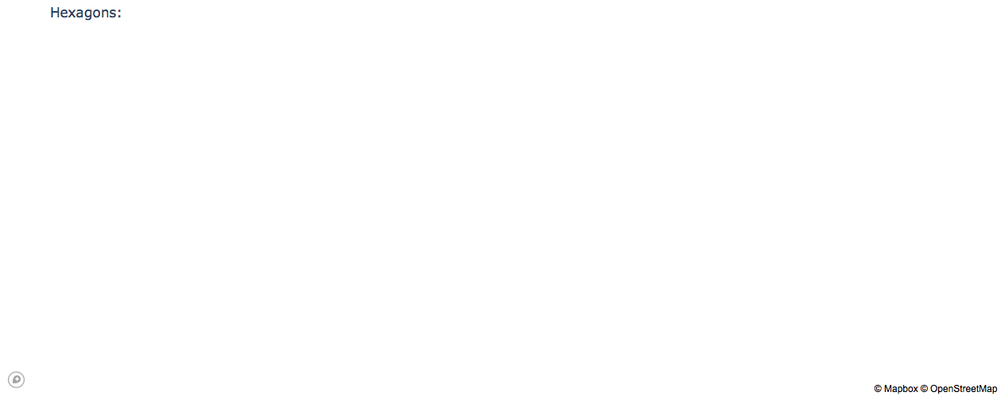

time: 344 ms (started: 2021-08-18 22:08:33 -03:00)


In [34]:
def return_circle(azimuth_step, radius, lat, long):
    lat = math.radians(lat)
    long = math.radians(long)
    temp_content=""
    azimuth = 30
    lat30 = 0
    long30 = 0
    while azimuth < 390:
        point = {}
        tc = math.radians(azimuth)
        temp_lat = math.degrees(math.asin(math.sin(lat)*math.cos(radius) + math.cos(lat)*math.sin(radius)*math.cos(tc)))
        if math.cos(long) == 0 :
            temp_lon = math.degrees(long)
        else:
            temp_lon = math.degrees(((long + math.asin(math.sin(tc)*math.sin(radius) / math.cos(lat)) + math.pi) % (2*math.pi)) - math.pi)

        if azimuth == 30:
            lat30 = temp_lat
            long30 = temp_lon
        if temp_content == "":
            temp_content = 'LINESTRING(' + str(round(temp_lon, 6)) + " " + str(round(temp_lat,6))
        else:
            temp_content = temp_content + ", " + str(round(temp_lon, 6)) + " " + str(round(temp_lat,6))
        azimuth += azimuth_step
    return temp_content +', '+ str(round(long30, 6)) + " " + str(round(lat30,6)) +')'

df_points = ""
# First try to read parquet file
try:
    df_points = pd.read_parquet('./parquet/points_check.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    # Create a list of points:
    azimuth_start = 0
    df_points = return_df_points(azimuth_start, curitiba_lat, curitiba_long, 0.3, 20)
    df_points.to_parquet('./parquet/points_check.parquet')
    cur.execute("TRUNCATE project.points4knn;")
    cur.execute("ALTER SEQUENCE project.points4knn_id_seq RESTART WITH 1;")
    print("Parquet file saved.")
    
    azimuth_step = 60 
    hexagon_apothem = 0.3 # km
    hexagon_radius = math.sqrt(4*hexagon_apothem**2/3) # in meters
    radius = hexagon_radius/distance.EARTH_RADIUS
    for index, row in df_points.iterrows():
        lat = row['lat']
        long = row['long']
        area = return_circle(azimuth_step, radius, lat, long)
        sql_insert = 'INSERT INTO project.points4knn (lat, long, point, area) VALUES (%s, %s, CAST(ST_SetSRID(ST_Point(%s, %s), 4326) AS geometry), CAST(ST_SetSRID(ST_MakePolygon( ST_GeomFromText(%s)), 4326) AS geometry));'
        cur.execute(sql_insert, (lat, long, long, lat, area))
psql.commit()
print('Dataframe have {} points.'.format(df_points.shape[0]))

draw_plotly_map("scatter", df_points, curitiba_lat, curitiba_long, None, None, px.colors.sequential.Bluered, 9.8, "Hexagons:", lat_column="lat", long_column="long")

### 4.2 Hexagons vs Geographic Data:  <a name="hexagons_geo"></a> ###

Using PostGIS to fill an Pandas dataframe.

#### 4.2.1 Socioeconomic data of each Hexagons:  <a name="hexagons_socioeconomic"></a> ####

In the database table, we have a column with the GeoJSON object of each hexagon. Similar information we have in the neighborhood table, with the borders of each neighborhood.
Using PostGIS functions and Socioeconomic data extracted from Wikipedia, we will calculate the area of each neighborhood overlapping each hexagon. Applying the proportionality of population and income to the overlapping area (about the neighborhood area), we will have this information for each hexagon.

To reduce the number of hexagons in the study and focus on regions with greater purchasing power, the SQL query filters the hexagons that make up 85% of the municipality's revenue.

In [91]:
#Income in Reais (R$) per month.
try:
    df_hexagon_socioeconomic = pd.read_parquet('./parquet/data_hexagon_socioeconomic.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_socioeconomic = pd.read_sql('select \
                                                t.id,\
                                                t.lat, \
                                                t.long, \
                                                t.persons,\
                                                t.income,\
                                                t.income/t.persons as avg_income\
                                            from\
                                                (select \
                                                    t.*,\
                                                    sum(income) over (order by income desc) as income_amount,\
                                                    sum(persons) over (order by persons desc) as persons_amount\
                                                from\
                                                    (select \
                                                        pk.id ,\
                                                        pk.lat,\
                                                        pk.long,\
                                                        round(sum(st_area(ST_Intersection(pk.area, gn.geometry)::geography)*dn.personpersqm)::numeric,2) as persons,\
                                                        round(sum(st_area(ST_Intersection(pk.area, gn.geometry)::geography)*dn.personpersqm*dn.avg_income)::numeric,2) as income,\
                                                        (SUM(round(sum(st_area(ST_Intersection(pk.area, gn.geometry)::geography)*dn.personpersqm)::numeric,2)) OVER ()) AS total_persons,\
                                                        (SUM(round(sum(st_area(ST_Intersection(pk.area, gn.geometry)::geography)*dn.personpersqm*dn.avg_income)::numeric,2)) OVER ()) AS total_income\
                                                    from \
                                                        project.points4knn pk left join\
                                                        project.geo_neighbourhood gn on ST_Intersects(pk.area, gn.geometry) left join \
                                                        project.data_neighbourhood dn on dn.norm_neighbourhood = gn.norm_neighbourhood\
                                                    group by pk.id) t\
                                                order by t.income desc) t\
                                            where \
                                                t.income_amount / total_income <= 0.85;', con=psql).set_index('id')
    df_hexagon_socioeconomic.to_parquet('./parquet/data_hexagon_socioeconomic.parquet')
df_hexagon_socioeconomic.head()

,lat,long,persons,income,avg_income
id,,,,,
481,-25.429425,-49.301793,2914.15,11052448.76,3792.683548
408,-25.432123,-49.296619,2914.09,11052206.70,3792.678572
340,-25.434821,-49.291444,2896.61,11046487.33,3813.591519
410,-25.434821,-49.301794,2911.16,11036708.26,3791.171993
342,-25.437519,-49.296619,2841.38,11028934.74,3881.541624


time: 3.33 s (started: 2021-08-18 23:13:35 -03:00)


#### 4.2.2 Master Plan of each Hexagons:  <a name="hexagons_masterplan"></a> ####

Applying the same logic as in the previous block, we calculate the overlapping area of each type of zone in the Master Plan. 

In [37]:
# Values in km^2
try:
    df_hexagon_masterplan = pd.read_parquet('./parquet/data_hexagon_masterplan.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_masterplan = pd.read_sql('select \
                                pk.id,\
                                round((sum(case when za.sg_short = \'ZC\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZC,\
                                round((sum(case when za.sg_short = \'ZUM\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZUM,\
                                round((sum(case when za.sg_short = \'CONEC\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as CONEC,\
                                round((sum(case when za.sg_short = \'ZS\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZS,\
                                round((sum(case when za.sg_short = \'ZT\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZT,\
                                round((sum(case when za.sg_short = \'APA\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as APA,\
                                round((sum(case when za.sg_short = \'ZI\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZI,\
                                round((sum(case when za.sg_short = \'ZE\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZE,\
                                round((sum(case when za.sg_short = \'SE\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as SE,\
                                round((sum(case when za.sg_short = \'UC\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as UC,\
                                round((sum(case when za.sg_short = \'ZR\' then st_area(ST_Intersection(pk.area, gmp.geometry)::geography) else 0 end)/1000)::numeric,2) as ZR\
                            from \
                                project.points4knn pk left join \
                                project.geo_master_plan gmp on ST_Intersects(pk.area, gmp.geometry) left join \
                                project.zones_adjust2 za on gmp.sg_zone = za.sg_zone\
                            where \
                                za.id is not null \
                            group by \
                                pk.id;', con=psql).set_index('id')
    df_hexagon_masterplan.to_parquet('./parquet/data_hexagon_masterplan.parquet')
del df_hexagon_masterplan['ze']
df_hexagon_masterplan.head()

Parquet file readed.


,zc,zum,conec,zs,zt,apa,zi,se,uc,zr
id,,,,,,,,,,
1,0.0,0.0,0.0,0.0,301.03,0.0,0.0,10.14,0.0,0.0
2,0.0,0.0,0.0,0.0,133.40,0.0,0.0,11.93,0.0,165.8
3,0.0,0.0,0.0,0.0,174.03,0.0,0.0,137.15,0.0,0.0
4,0.0,0.0,0.0,0.0,124.12,0.0,0.0,187.05,0.0,0.0
5,0.0,0.0,0.0,0.0,89.49,0.0,0.0,221.67,0.0,0.0


time: 63 ms (started: 2021-08-18 22:09:57 -03:00)


#### 4.2.3 Main Streets of each Hexagons:  <a name="hexagons_mainstreets"></a> ####

Applying the same logic, we calculate the lenght of each type of Main Streets in each hexagon. 

In [38]:
#Values em meters
try:
    df_hexagon_main_street = pd.read_parquet('./parquet/data_hexagon_main_street.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_main_street = pd.read_sql('select \
                            pk.id,\
                            round(sum(case when gms.sub_system = \'ANEL CENTRAL\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as central_ring,\
                            round(sum(case when gms.sub_system = \'CENTRAL\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as central,\
                            round(sum(case when gms.sub_system IN (\'COLETORA 1\', \'COLETORA 2\', \'COLETORA 3\') then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as collector,\
                            round(sum(case when gms.sub_system = \'EXTERNA\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as external,\
                            round(sum(case when gms.sub_system = \'LINHÃO\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as main_line,\
                            round(sum(case when gms.sub_system = \'OUTRAS VIAS\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as other_routes ,\
                            round(sum(case when gms.sub_system IN (\'PRIORITÁRIA 1\', \'PRIORITÁRIA 2\') then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as priority,\
                            round(sum(case when gms.sub_system = \'SETORIAL\' then ST_LENGTH(ST_Intersection(pk.area, gms.geometry)::geography) else 0 end)::numeric,2) as sectorial\
                        from \
                            project.points4knn pk left join\
                            project.geo_main_streets gms on ST_Intersects(pk.area, gms.geometry)\
                        group by \
                            pk.id;', con=psql).set_index('id')
    df_hexagon_main_street.to_parquet('./parquet/data_hexagon_main_street.parquet')

df_hexagon_main_street.head()

Parquet file readed.


,central_ring,central,collector,external,main_line,other_routes,priority,sectorial
id,,,,,,,,
1,0.0,0.0,655.12,0.0,0.0,0.0,0.0,603.70
2,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.00
3,0.0,0.0,417.75,0.0,0.0,0.0,0.0,0.00
4,0.0,0.0,545.90,0.0,0.0,0.0,0.0,761.13
5,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.00


time: 94 ms (started: 2021-08-18 22:10:24 -03:00)


#### 4.2.4 Extras of each Hexagons:  <a name="hexagons_mainstreets"></a> ####

Applying the same logic, we calculate the overlapping area of each type 'extras' in Curitiba.

In [39]:
try:
    df_hexagon_extras = pd.read_parquet('./parquet/data_hexagon_extras.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_extras = pd.read_sql('select \
                            pk.id,\
                            round(sum(case when ge."type" IN (\'JARDIM BOTÂNICO\', \'PARQUE LINEAR\', \'PARQUE\', \'BOSQUE\') then st_area(ST_Intersection(pk.area, ge.geometry)::geography) else 0 end)::numeric,2) as "Park",\
                            round(sum(case when ge."type" IN (\'EIXO DE ANIMAÇÃO\', \'CENTRO ESPORTIVO\', \'CENTRO POLIESPORTIVO\') then st_area(ST_Intersection(pk.area, ge.geometry)::geography) else 0 end)::numeric,2) as "Sport Center",\
                            round(sum(case when ge."type" IN (\'JARDIM AMBIENTAL\', \'LARGO\', \'NÚCLEO AMBIENTAL\', \'JARDIM\', \'JARDINETE\', \'RECANTO\') then st_area(ST_Intersection(pk.area, ge.geometry)::geography) else 0 end)::numeric,2) as "Garden",\
                            round(sum(case when ge."type" IN (\'PRAÇA\', \'CALÇADÃO\') then st_area(ST_Intersection(pk.area, ge.geometry)::geography) else 0 end)::numeric,2) as "Public Square"\
                        from \
                            project.points4knn pk left join\
                            project.geo_extras ge on ST_Intersects(pk.area, ge.geometry)\
                        group by pk.id;', con=psql).set_index('id')
    df_hexagon_extras.to_parquet('./parquet/data_hexagon_extras.parquet')

df_hexagon_extras.head()

Parquet file readed.


,Park,Sport Center,Garden,Public Square
id,,,,
1,0.0,0.0,0.00,0.00
2,0.0,0.0,12.49,1070.04
3,0.0,0.0,0.00,0.00
4,0.0,0.0,0.00,1573.27
5,0.0,0.0,0.00,0.00


time: 63 ms (started: 2021-08-18 22:11:24 -03:00)


### 4.3 Processing data: <a name="processing_data"></a> ###

As a first action, let's put all data in the same dataframe.

In [92]:
mergedDf = df_hexagon_socioeconomic.merge(df_hexagon_masterplan, left_index=True, right_index=True).merge(df_hexagon_main_street, left_index=True, right_index=True).merge(df_hexagon_extras, left_index=True, right_index=True)
mergedDf.head()

,lat,long,persons,income,avg_income,zc,zum,conec,zs,zt,...,collector,external,main_line,other_routes,priority,sectorial,Park,Sport Center,Garden,Public Square
id,,,,,,,,,,,,,,,,,,,,,
481,-25.429425,-49.301793,2914.15,11052448.76,3792.683548,0.0,0.0,0.0,0.0,0.0,...,0.00,85.38,0.0,4.99,0.00,0.0,0.0,0.0,0.00,0.00
408,-25.432123,-49.296619,2914.09,11052206.70,3792.678572,0.0,0.0,0.0,0.0,0.0,...,0.00,1172.82,0.0,806.03,531.83,0.0,0.0,0.0,0.00,0.00
340,-25.434821,-49.291444,2896.61,11046487.33,3813.591519,0.0,0.0,0.0,0.0,0.0,...,217.78,0.00,0.0,0.00,1238.67,0.0,0.0,0.0,170.65,4258.76
410,-25.434821,-49.301794,2911.16,11036708.26,3791.171993,0.0,0.0,0.0,0.0,0.0,...,65.29,1030.96,0.0,1159.63,0.00,0.0,0.0,0.0,0.00,162.54
342,-25.437519,-49.296619,2841.38,11028934.74,3881.541624,0.0,0.0,0.0,0.0,0.0,...,0.00,0.00,0.0,0.00,0.00,0.0,0.0,0.0,75.39,2704.50


time: 93 ms (started: 2021-08-18 23:14:10 -03:00)


#### 4.3.1 Normalizing:  <a name="normalizing"></a> ####

In [93]:
X = mergedDf.values[:,2:]
X = np.nan_to_num(X)
cluster_dataset = StandardScaler().fit_transform(X)
cluster_dataset

array([[ 2.06061053,  4.02208874,  2.40391169, ..., -0.084841  ,
        -0.48680907, -0.47556777],
       [ 2.06051196,  4.02197078,  2.40390594, ..., -0.084841  ,
        -0.48680907, -0.47556777],
       [ 2.03179618,  4.01918371,  2.42805612, ..., -0.084841  ,
        -0.32952678,  0.34564744],
       ...,
       [-0.68513077, -0.79917745, -0.89917671, ..., -0.084841  ,
        -0.48680907, -0.47556777],
       [-1.27769769, -0.8024289 , -0.46760188, ..., -0.084841  ,
        -0.36713997, -0.47556777],
       [-1.16570942, -0.80278896, -0.57670558, ..., -0.084841  ,
        -0.48680907,  0.53805287]])

time: 15 ms (started: 2021-08-18 23:14:27 -03:00)


#### 4.3.2 Clustering:  <a name="clustering"></a> ####

Using the 'KMeans' function of scikit-learn, we will cluster the study areas into 12 groups.

In [94]:
num_clusters = 12

k_means = KMeans(init="k-means++", n_clusters=num_clusters)
k_means.fit(cluster_dataset)
labels = k_means.labels_

mergedDf["Cluster"] = labels
mergedDf.head(5)


,lat,long,persons,income,avg_income,zc,zum,conec,zs,zt,...,external,main_line,other_routes,priority,sectorial,Park,Sport Center,Garden,Public Square,Cluster
id,,,,,,,,,,,,,,,,,,,,,
481,-25.429425,-49.301793,2914.15,11052448.76,3792.683548,0.0,0.0,0.0,0.0,0.0,...,85.38,0.0,4.99,0.00,0.0,0.0,0.0,0.00,0.00,8
408,-25.432123,-49.296619,2914.09,11052206.70,3792.678572,0.0,0.0,0.0,0.0,0.0,...,1172.82,0.0,806.03,531.83,0.0,0.0,0.0,0.00,0.00,2
340,-25.434821,-49.291444,2896.61,11046487.33,3813.591519,0.0,0.0,0.0,0.0,0.0,...,0.00,0.0,0.00,1238.67,0.0,0.0,0.0,170.65,4258.76,8
410,-25.434821,-49.301794,2911.16,11036708.26,3791.171993,0.0,0.0,0.0,0.0,0.0,...,1030.96,0.0,1159.63,0.00,0.0,0.0,0.0,0.00,162.54,2
342,-25.437519,-49.296619,2841.38,11028934.74,3881.541624,0.0,0.0,0.0,0.0,0.0,...,0.00,0.0,0.00,0.00,0.0,0.0,0.0,75.39,2704.50,8


time: 485 ms (started: 2021-08-18 23:14:37 -03:00)


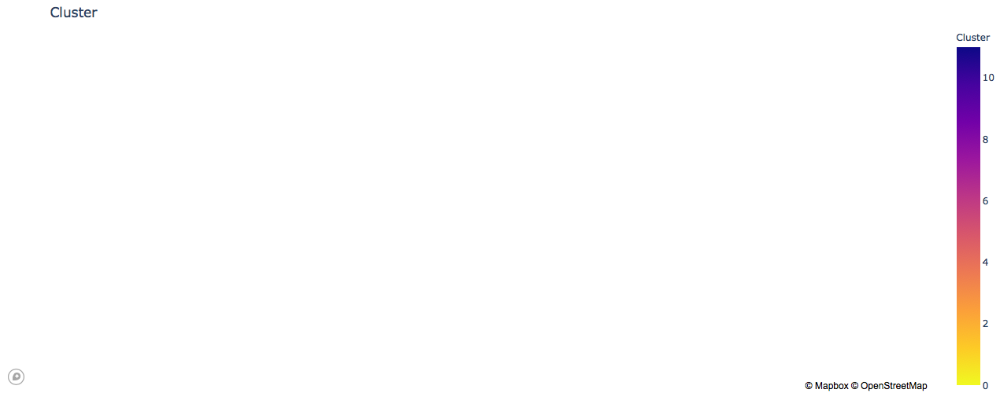

time: 234 ms (started: 2021-08-19 00:07:56 -03:00)


In [114]:
draw_plotly_map("scatter", mergedDf, curitiba_lat, curitiba_long, ["Cluster"], "Cluster", px.colors.sequential.Plasma_r, 9.8, "Cluster", lat_column="lat", long_column="long")

### 4.4 Bringing Foursquere data into analysis: <a name="foursquare2analysis"></a> ###

Up to this point in the study, no information from Foursquare has been used, as until then the aim was to classify the points based on their geographic, socioeconomic and legal characteristics.
To evolve the analysis, let's add information about the establishments we collected from Foursquere. We will not treat the establishments individually, but based on the hexagons in the study.

#### 4.4.1 Venues per Hexagon: <a name="venuesperhexagon"></a> ####

In [96]:
try:
    df_hexagon_venues = pd.read_parquet('./parquet/data_hexagon_venues.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_venues = pd.read_sql('select \
                        pk.id,\
                        count(*) as num_venues,\
                        sum(case when fv.tier >= 2 then 1 else 0 end) as high_tier,\
                        sum(case when fv.rating >= 7.5 then 1 else 0 end) as high_rating,\
                        max(fv.tier) as max_tier,\
                        avg(fv.tier) as avg_tier,\
                        max(fv.tipcount) as max_tipcount,\
                        avg(fv.tipcount) as avg_tipcount,\
                        sum(case when fv.tier >2 then fv.tipcount else null end) as sum_tipcount2high_tier,\
                        max(fv.rating) as max_rating,\
                        avg(fv.rating) as avg_rating,\
                        sum(case when fv.tier >= 2 then fv.rating else null end) as sum_rating2high_tier,\
                        max(fv.likes) as max_likes,\
                        avg(fv.likes) as avg_likes,\
                        sum(case when fv.tier >= 2 then fv.likes else null end) as sum_likes2high_tier\
                    from\
                        project.points4knn pk left join\
                        project.foursquare_venues fv on ST_Intersects(pk.area, fv.geo_point) and fv.categories::jsonb->0 = \'["Bakery", "4bf58dd8d48988d16a941735"]\'::jsonb\
                    group by pk.id;', con=psql).set_index('id')
    df_hexagon_venues.to_parquet('./parquet/data_hexagon_venues.parquet')

df_cluster = mergedDf.merge(df_hexagon_venues, left_index=True, right_index=True)
df_hexagon_venues.head()

Parquet file readed.


,num_venues,high_tier,high_rating,max_tier,avg_tier,max_tipcount,avg_tipcount,sum_tipcount2high_tier,max_rating,avg_rating,sum_rating2high_tier,max_likes,avg_likes,sum_likes2high_tier
id,,,,,,,,,,,,,,
1,1,0,1,1.0,1.0,7.0,7.0,NaN,7.6,7.6,NaN,45.0,45.0,NaN
2,1,0,0,1.0,1.0,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN
3,2,1,1,2.0,1.5,36.0,18.0,NaN,8.4,4.2,8.4,120.0,60.0,120.0
4,1,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


time: 63 ms (started: 2021-08-18 23:15:07 -03:00)


#### 4.4.2 Venues distance to Hexagon: <a name="venuesdistancehexagon"></a> ####

In [97]:
try:
    df_hexagon_dist_venues = pd.read_parquet('./parquet/data_hexagon_dist_venues.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_hexagon_dist_venues = pd.read_sql('select \
                        pk.id,\
                       	MIN(case when fv.tier >= 2 then ST_Distance(fv.geo_point::geography , pk.area::geography) else NULL end) as dist_hightier, \
                        MIN(case when fv.rating >= 7.5 then ST_Distance(fv.geo_point::geography , pk.area::geography) else NULL end) as dist_highrating, \
                        MIN(case when fv.tier >= 2 then ST_Distance(fv.geo_point::geography , pk.area::geography) else NULL end) + MIN(case when fv.rating >= 9 then ST_Distance(fv.geo_point::geography , pk.area::geography) else NULL end) as diff_dist \
                    from \
                        project.points4knn pk, \
                        project.foursquare_venues fv \
                    where \
                        fv.categories::jsonb->0 = \'["Bakery", "4bf58dd8d48988d16a941735"]\'::jsonb \
                    group by pk.id;', con=psql).set_index('id') 
    df_hexagon_dist_venues.to_parquet('./parquet/data_hexagon_dist_venues.parquet')

df_cluster = df_cluster.merge(df_hexagon_dist_venues, left_index=True, right_index=True)
df_hexagon_dist_venues.head()

Parquet file readed.


,dist_hightier,dist_highrating,diff_dist
id,,,
1,149.824551,0.000000,2076.084440
2,62.665183,62.665183,2041.469449
3,0.000000,0.000000,2517.625989
4,388.541513,356.527055,2579.409817
5,694.944242,340.206903,2285.574523


time: 31 ms (started: 2021-08-18 23:15:17 -03:00)


#### 4.5 Defining the relevant clusters: <a name="relevant_clusters"></a> ####

With the information of Bakeries per hexagon and the cluster of each hexagon, we can select the clusters with the highest averages of bakeries per hexagon.

In [98]:
import collections
bakery_cluster = {}
for index, row in df_cluster.iterrows():
    key = int(row['Cluster'])
    if key in bakery_cluster:
        bakery_cluster[key]['points'] += 1
        if row['high_rating'] > 0:
            bakery_cluster[key]['backerys'] += int(row['high_rating'])
            bakery_cluster[key]['mean'] = bakery_cluster[key]['backerys'] / bakery_cluster[key]['points']
    else:
        info = {}
        info['points'] = 1
        info['backerys'] = int(row['high_rating'])
        info['mean'] = int(row['high_rating'])
        bakery_cluster.setdefault(key,info)

df_cluster_start=pd.DataFrame(bakery_cluster).transpose().sort_values(by='mean',ascending=False)
df_cluster_start

,points,backerys,mean
2,46.0,13.0,0.590909
3,6.0,1.0,0.333333
8,42.0,10.0,0.256410
7,30.0,2.0,0.166667
1,150.0,10.0,0.097087
5,251.0,21.0,0.085366
0,89.0,7.0,0.079545
9,42.0,0.0,0.000000
11,26.0,0.0,0.000000
6,3.0,0.0,0.000000


time: 188 ms (started: 2021-08-18 23:15:34 -03:00)


In [101]:
filter_df = df_cluster[df_cluster["Cluster"].isin([2, 3, 8])]

time: 0 ns (started: 2021-08-18 23:16:47 -03:00)


#### 4.6 A peek in the data: <a name="peakindata"></a> ####

Based on the classification of the clusters, we will analyze the clusters with an average of bakers per hexagon greater than 25% (0.25). In our case it will be clusters 2, 3 and 8.

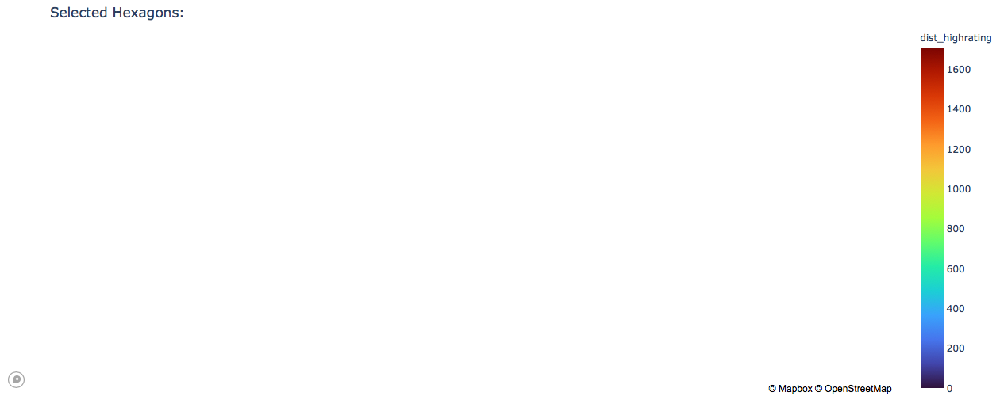

time: 172 ms (started: 2021-08-18 23:17:15 -03:00)


In [102]:
draw_plotly_map("scatter", filter_df, curitiba_lat, curitiba_long, ["persons", "income", "dist_highrating", "Cluster"], "dist_highrating", px.colors.sequential.Turbo, 9.8, "Selected Hexagons:", lat_column="lat", long_column="long")

As we can see in the map above, analyzing only the distance between a hexagon and the closest high-income bakery, the choice would fall to the extreme points (greater distance). But continuing the analysis, we have more information that can help us in the analysis:
* What is the population in these hexagons?
* What is the average income on these hexagons?

##### 4.6.1 Hexagon per Population and per Income: <a name="hexagos_pop_income"></a> #####

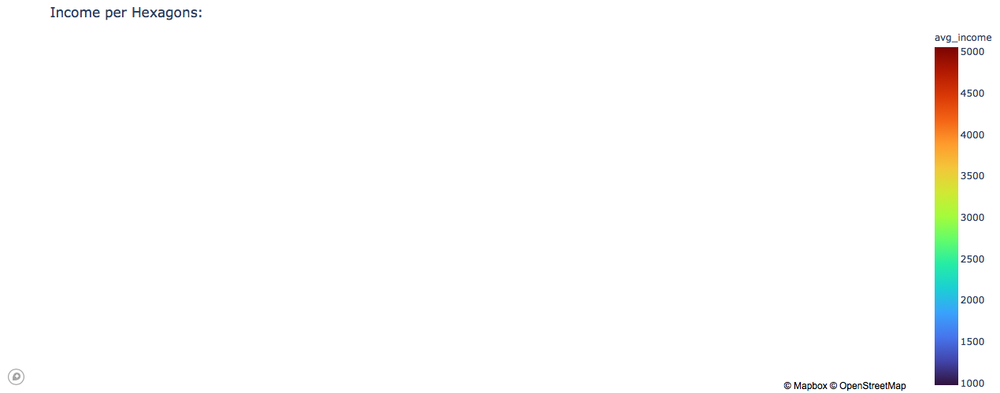

time: 265 ms (started: 2021-08-19 00:05:35 -03:00)


In [113]:
draw_plotly_map("scatter", filter_df, curitiba_lat, curitiba_long, ["persons", "avg_income", "dist_highrating", "Cluster"], "avg_income", px.colors.sequential.Turbo, 9.8, "Income per Hexagons:", lat_column="lat", long_column="long")

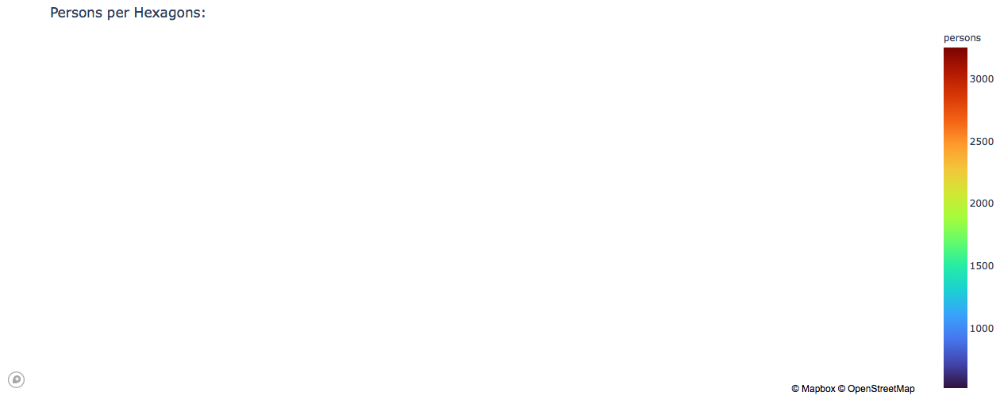

time: 187 ms (started: 2021-08-18 23:18:10 -03:00)


In [104]:
draw_plotly_map("scatter", filter_df, curitiba_lat, curitiba_long, ["persons", "income", "dist_highrating", "Cluster"], "persons", px.colors.sequential.Turbo, 9.8, "Persons per Hexagons:", lat_column="lat", long_column="long")

Analyzing the income and population distribution maps, we have a clear population cleavage, without a direct correlation between population and income (characteristics of the Brazilian population).

According to data from IBGE (Brazilian Institute of Geography and Statistics) in 2019 the GINI index of socioeconomic inequality in Brazil was 0.539, placing the country in 159th position [^3].

*"In 2019, the 10% share of people with the lowest per capita household income received a share of 0.8% of the total income. Half of the Brazilian population corresponded to 15.6% of the observed income, while the 10% with the highest earnings 42.9% of all income received by people in 2019."*

[^3]: https://biblioteca.ibge.gov.br/visualizacao/livros/liv101760.pdf 

#### 4.7 Ranking: <a name="peakindata"></a> ####

In an attempt to focus on regions with an adequate balance between population, income and distance to another well-rated bakery (rating greater than 7.5), we propose a metric considering all these variables.

![Relevance Equation](https://raw.githubusercontent.com/ftauscheck/The-Battle-of-the-Neighborhoods/main/img/02.relevance.png?style=centerme)

*To avoid distortions with hexagons with very small distances, we are filtering cases with less than 300m of distance for a bakery.*

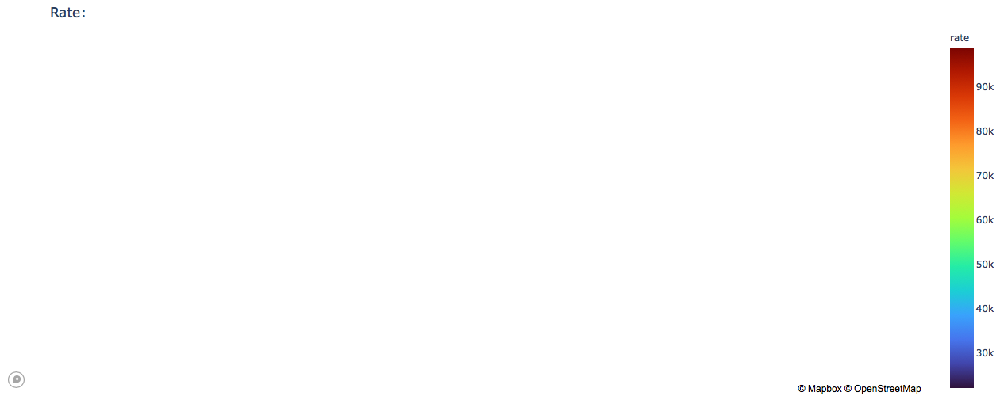

time: 281 ms (started: 2021-08-18 23:21:11 -03:00)


In [106]:
df2 = filter_df[filter_df.dist_highrating > 300]
df2 = df2.loc[:, ['income', 'dist_highrating', 'persons']]
df2['rate'] = (df2['income']/df2['persons']*np.sqrt(df2['dist_highrating']))
del df2['income']
del df2['dist_highrating']
del df2['persons']
filter_rate = filter_df.merge(df2, left_index=True, right_index=True).sort_values(by='rate',ascending=False)

draw_plotly_map("scatter", filter_rate, curitiba_lat, curitiba_long, ["rate", "persons", "income", "avg_income", "dist_highrating", "Cluster"], "rate", px.colors.sequential.Turbo, 9.8, "Rate:", lat_column="lat", long_column="long")

Finaly, let's **reverse geocode those candidate area centers to get the addresses** which can be presented to stakeholders.

In [112]:
def get_address(api_key, latitude, longitude, verbose=False):
    try:
        url = 'https://maps.googleapis.com/maps/api/geocode/json?key={}&latlng={},{}'.format(api_key, latitude, longitude)
        response = requests.get(url).json()
        if verbose:
            print('Google Maps API JSON result =>', response)
        results = response['results']
        address = results[0]['formatted_address']
        return address
    except:
        return None

    
try:
    df_rank = pd.read_parquet('./parquet/data_rank.parquet1', engine='fastparquet')
    print("Parquet file readed.")
except:
    rank = 1
    temp_content=[]
    for index, row in filter_rate.iterrows():
        addr = get_address(gmaps_token, row['lat'], row['long']).replace(', Brazil', '')
        point = {}
        point['rank'] = rank
        point['addr'] = addr
        point['persons'] = row['persons']
        point['income'] = row['income']
        point['max_rating'] = row['max_rating']
        point['dist_highrating'] = row['dist_highrating']
        point['rate'] = row['rate']
        point['lat'] = row['lat']
        point['long'] = row['long']
        temp_content.append(point)
        rank += 1
    df_rank=pd.DataFrame(temp_content)
    df_rank.to_parquet('./parquet/data_rank.parquet')
    df_rank.to_csv('./csv/rank.csv', index=False)
    
df_rank.head()

,rank,addr,persons,income,max_rating,dist_highrating,rate,lat,long
0,1,"Rua Cleide Iurk, 65 - Bacacheri, Curitiba - PR...",1191.63,3110706.45,0.0,1436.690589,98946.223906,-25.388955,-49.234533
1,2,"Av. Vicente Machado, 1039 - Centro, Curitiba -...",2207.75,10830081.16,6.1,382.304343,95914.978460,-25.437519,-49.286269
2,3,"R. Prof. Benedito Nicolau dos Santos, 522 - Ce...",1333.71,3589838.74,NaN,738.380648,73139.786013,-25.413237,-49.270744
3,4,"R. Imac. Conceição, 247 - Rebouças, Curitiba -...",1489.91,3216532.29,0.0,1071.770771,70677.118494,-25.442915,-49.255219
4,5,"R. Ubaldino do Amaral, 334 - Alto da Glória, C...",2208.14,6287645.07,0.0,573.504790,68191.452002,-25.424029,-49.260396


time: 7.47 s (started: 2021-08-18 23:35:24 -03:00)


With this, we concludes our analysis. We have created a list with 34 zones with similar geographic and socioeconomic characteristics with adequate distance to other well-regarded bakeries in the region. Additionally, we were able to create a metric to assist our stakeholders in defining which regions should be evaluated first.

## 5 Results and Discussion: <a name="Results"></a> ##

Our analysis shows that although there is a great number of bakerys in Curitiba (~600), there are regions in the city with characteristics that have more bakeries. 

The characteristics of this regions can be varied, but analyzing the distribution of points, we can observe that regions with avenues dedicated to the flow of people (either through public transport in segregated lanes, or in lanes with large car capacity) tend to have more bakeries.

After crossing these data, clustering the points and later filtering them, we ended up with a list of 34 addresses that have high potential for a new bakery. This, of course, does not imply that these zones are necessarily the best places for a new bakery. Purpose of this analysis was to only provide info on areas with similarity to other well ranked bakerys and with good distance to avoide unnecessary competition.

## 6 Conclusion: <a name="Conclusion"></a> ##

Purpose of this project was to identify Curitiba areas in order to aid stakeholders in narrowing down the search for optimal location for a new Bakery. By crossing socioeconomic and geographic information with the distribution os Bakerys from Foursquare data, we create a list of zones of interest and addresses to be used as starting points for final exploration by stakeholders.

Final decision on optimal bakery location will be made by stakeholders based on specific characteristics of neighborhoods and locations in every recommended zone, taking into consideration additional factors like attractiveness of each location (proximity to park or water), levels of noise / proximity to major roads, real estate availability, prices, social and economic dynamics of every neighborhood etc.